In [1]:
%matplotlib inline

import os
import re
import numpy as np

import keras_tuner as kt
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.layers import TextVectorization

from data import load_captions_data, train_val_split
from processing import custom_standardization, make_dataset, decode_and_resize
from models import TransformerEncoderBlock, TransformerDecoderBlock, get_cnn_model, ImageCaptioningModel
from training import LRSchedule, generate_caption

seed = 111
np.random.seed(seed)
tf.random.set_seed(seed)

In [2]:
# Training parameters
AUTOTUNE = tf.data.AUTOTUNE
IMAGES_PATH = "data/Flicker8k_Dataset"
IMAGE_SIZE = (299, 299)
VOCAB_SIZE = 5000
SEQ_LENGTH = 25
EPOCHS = 30
BATCH_SIZE = 64

In [3]:
# Load the dataset
captions_mapping, text_data = load_captions_data(IMAGES_PATH, "data/Flickr8k.token.txt", SEQ_LENGTH)

train_data, valid_data = train_val_split(captions_mapping)
print("Number of training samples: ", len(train_data))
print("Number of validation samples: ", len(valid_data))

Number of training samples:  6114
Number of validation samples:  1529


In [4]:
vectorization = TextVectorization(
    max_tokens=VOCAB_SIZE,
    output_mode="int",
    output_sequence_length=SEQ_LENGTH,
    standardize=custom_standardization,
)
vectorization.adapt(text_data)

In [5]:
# Pass the list of images and the list of corresponding captions
train_dataset = make_dataset(list(train_data.keys()), list(train_data.values()),
                             IMAGE_SIZE, vectorization,
                             BATCH_SIZE, AUTOTUNE)
valid_dataset = make_dataset(list(valid_data.keys()), list(valid_data.values()),
                             IMAGE_SIZE, vectorization,
                             BATCH_SIZE, AUTOTUNE)

In [6]:
# Only including non data processing hyperparameters
def caption_model_builder(hp):
    EMBED_DIM = hp.Int('embedd_dim', min_value=512, max_value=1024, step=128)
    FF_DIM = hp.Int('ff_dim', min_value=512, max_value=1024, step=128)
    ENCODER_HEADS = hp.Int('encoder_heads', min_value=1, max_value=5, step=1)
    DECODER_HEADS = hp.Int('decoder_heads', min_value=1, max_value=5, step=1)
    LR = hp.Choice('learning_rate', values=[1e-4])
    AMS = hp.Boolean('ams_grad', default = True)
    ROTATION = hp.Float('random_rotation', min_value=0, max_value=0.5, step=0.05)
    CONTRAST = hp.Float('random_contrast', min_value=0.05, max_value=0.5, step=0.05)
    ZOOM = hp.Float('random_zoom', min_value=0, max_value=0.25, step=0.05)
    DROPOUT = hp.Float('dropout', min_value=0.0, max_value=0.3, step=0.05)
    
    # Data augmentation for image data
    image_augmentation = keras.Sequential(
        [
            layers.RandomFlip("horizontal"),
            layers.RandomRotation(ROTATION),
            layers.RandomContrast(CONTRAST),
            layers.RandomZoom(height_factor = ZOOM, width_factor = ZOOM)
        ]
    )
    cnn_model = get_cnn_model(IMAGE_SIZE)
    encoder = TransformerEncoderBlock(embed_dim=EMBED_DIM, dense_dim=FF_DIM, num_heads=ENCODER_HEADS)
    decoder = TransformerDecoderBlock(embed_dim=EMBED_DIM, ff_dim=FF_DIM, num_heads=DECODER_HEADS,
                                      seq_length=SEQ_LENGTH, vocab_size=VOCAB_SIZE, dropout=DROPOUT)
    caption_model = ImageCaptioningModel(cnn_model=cnn_model, encoder=encoder, decoder=decoder,
                                         image_aug=image_augmentation)

    # Define the loss function
    cross_entropy = keras.losses.SparseCategoricalCrossentropy(from_logits=False, reduction="none")

    # Create a learning rate schedule
    num_warmup_steps = (len(train_dataset) * EPOCHS) // 15
    
    lr_schedule = LRSchedule(post_warmup_learning_rate=LR, warmup_steps=num_warmup_steps)

    # Compile the model
    caption_model.compile(optimizer=keras.optimizers.Adam(lr_schedule, amsgrad=AMS), loss=cross_entropy)

    return caption_model

In [7]:
tuner = kt.Hyperband(caption_model_builder,
                     objective = 'val_acc',
                     max_epochs = EPOCHS,
                     factor = 3,
                     seed = 0,
                     directory = 'model_tuner',
                     project_name = 'image_captioning')
tuner.search_space_summary()

Search space summary
Default search space size: 10
embedd_dim (Int)
{'default': None, 'conditions': [], 'min_value': 512, 'max_value': 1024, 'step': 128, 'sampling': None}
ff_dim (Int)
{'default': None, 'conditions': [], 'min_value': 512, 'max_value': 1024, 'step': 128, 'sampling': None}
encoder_heads (Int)
{'default': None, 'conditions': [], 'min_value': 1, 'max_value': 5, 'step': 1, 'sampling': None}
decoder_heads (Int)
{'default': None, 'conditions': [], 'min_value': 1, 'max_value': 5, 'step': 1, 'sampling': None}
learning_rate (Choice)
{'default': 0.0001, 'conditions': [], 'values': [0.0001], 'ordered': True}
ams_grad (Boolean)
{'default': True, 'conditions': []}
random_rotation (Float)
{'default': 0.0, 'conditions': [], 'min_value': 0.0, 'max_value': 0.5, 'step': 0.05, 'sampling': None}
random_contrast (Float)
{'default': 0.05, 'conditions': [], 'min_value': 0.05, 'max_value': 0.5, 'step': 0.05, 'sampling': None}
random_zoom (Float)
{'default': 0.0, 'conditions': [], 'min_value': 

In [8]:
with open('vocabulary.tsv', 'w') as f:
    for word in vectorization.get_vocabulary():
        print(word, file = f)

In [9]:
tuner.search(train_dataset, validation_data = valid_dataset,
             callbacks=[keras.callbacks.EarlyStopping(monitor='val_acc', patience=3, restore_best_weights=True),
                        keras.callbacks.TensorBoard(log_dir="model_log", histogram_freq=1, write_graph=False,
                                                    write_images=True, write_steps_per_second=False, update_freq='epoch',
                                                    profile_batch=0, embeddings_freq=1, embeddings_metadata='vocabulary.tsv')])

Trial 90 Complete [00h 12m 50s]
val_acc: 0.41342154145240784

Best val_acc So Far: 0.41503632068634033
Total elapsed time: 07h 31m 30s
INFO:tensorflow:Oracle triggered exit


{'embedd_dim': 768, 'ff_dim': 768, 'encoder_heads': 1, 'decoder_heads': 3, 'learning_rate': 0.0001, 'ams_grad': False, 'random_rotation': 0.05, 'random_contrast': 0.45, 'random_zoom': 0.05, 'dropout': 0.15000000000000002, 'tuner/epochs': 30, 'tuner/initial_epoch': 10, 'tuner/bracket': 1, 'tuner/round': 1, 'tuner/trial_id': 'e933d8ec4cd8e21cdc0dbf71f0f84257'}
Epoch 1/30
96/96 [==============================] - ETA: 0s - loss: 23.9940 - acc: 0.1786

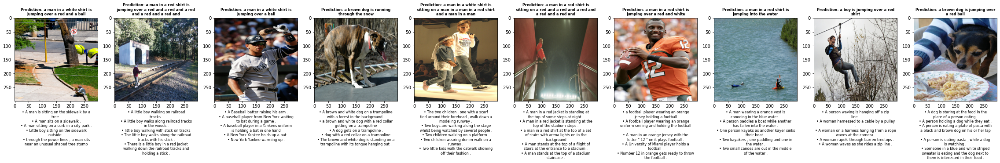

96/96 [==============================] - 64s 574ms/step - loss: 23.9940 - acc: 0.1795 - val_loss: 17.9981 - val_acc: 0.3490
Epoch 2/30
96/96 [==============================] - ETA: 0s - loss: 16.8143 - acc: 0.3584

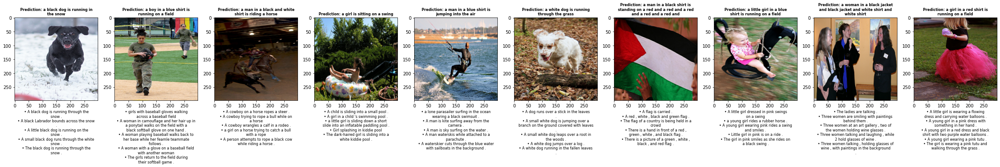

96/96 [==============================] - 51s 524ms/step - loss: 16.8143 - acc: 0.3585 - val_loss: 16.0869 - val_acc: 0.3804
Epoch 3/30
96/96 [==============================] - ETA: 0s - loss: 15.0180 - acc: 0.3948

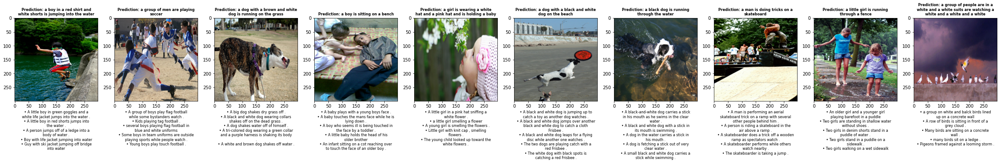

96/96 [==============================] - 49s 509ms/step - loss: 15.0180 - acc: 0.3949 - val_loss: 15.2309 - val_acc: 0.3945
Epoch 4/30
96/96 [==============================] - ETA: 0s - loss: 13.8437 - acc: 0.4213

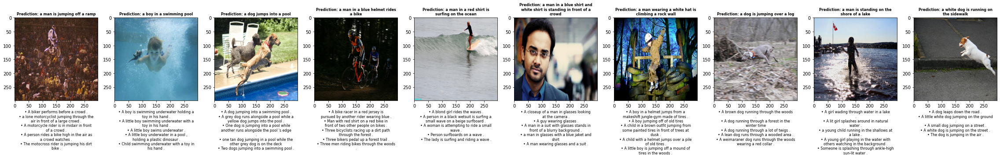

96/96 [==============================] - 49s 511ms/step - loss: 13.8437 - acc: 0.4213 - val_loss: 14.7790 - val_acc: 0.4011
Epoch 5/30
96/96 [==============================] - ETA: 0s - loss: 12.9417 - acc: 0.4417

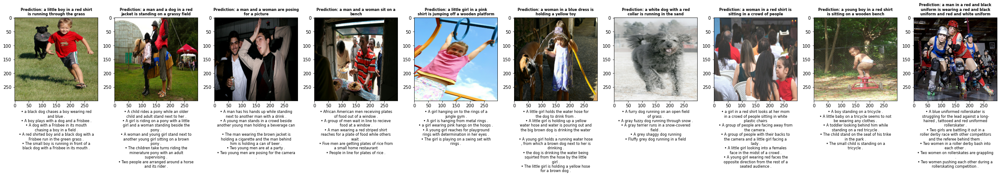

96/96 [==============================] - 49s 511ms/step - loss: 12.9417 - acc: 0.4417 - val_loss: 14.5186 - val_acc: 0.4074
Epoch 6/30
96/96 [==============================] - ETA: 0s - loss: 12.1548 - acc: 0.4638

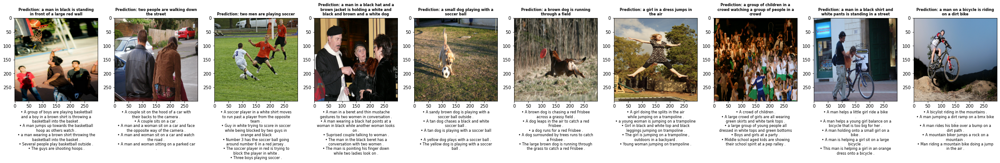

96/96 [==============================] - 49s 507ms/step - loss: 12.1548 - acc: 0.4638 - val_loss: 14.4047 - val_acc: 0.4090
Epoch 7/30
96/96 [==============================] - ETA: 0s - loss: 11.4529 - acc: 0.4812

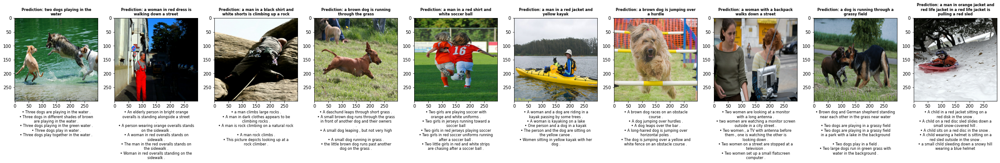

96/96 [==============================] - 49s 506ms/step - loss: 11.4529 - acc: 0.4812 - val_loss: 14.3414 - val_acc: 0.4124
Epoch 8/30
96/96 [==============================] - ETA: 0s - loss: 10.8262 - acc: 0.5004

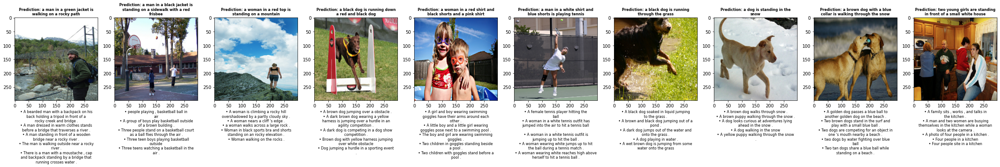

96/96 [==============================] - 49s 509ms/step - loss: 10.8262 - acc: 0.5004 - val_loss: 14.4086 - val_acc: 0.4082
Epoch 9/30
96/96 [==============================] - ETA: 0s - loss: 10.2035 - acc: 0.5168

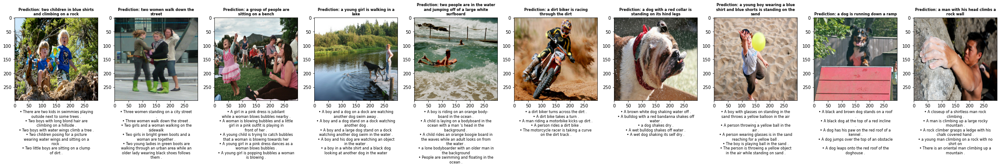

96/96 [==============================] - 49s 512ms/step - loss: 10.2035 - acc: 0.5168 - val_loss: 14.4773 - val_acc: 0.4090
Epoch 10/30
96/96 [==============================] - ETA: 0s - loss: 9.6642 - acc: 0.5343

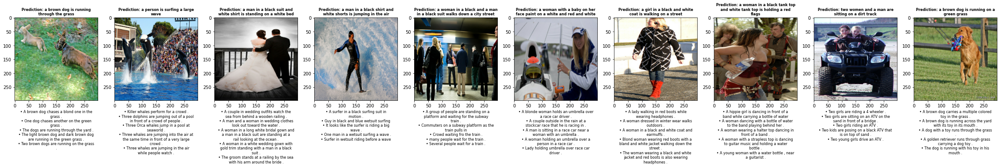

96/96 [==============================] - 49s 514ms/step - loss: 9.6642 - acc: 0.5343 - val_loss: 14.6128 - val_acc: 0.4075


In [47]:
# Callback to vieww values after each epoch
class EvaluateCaptions(keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        generate_caption(self.model, vectorization, valid_data = valid_data,
                         seq_length = SEQ_LENGTH, image_size = IMAGE_SIZE, samples = 10)

best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]
print(best_hps.values)
# Build the model with the optimal hyperparameters and train it on the data
caption_model = tuner.hypermodel.build(best_hps)

# Fit the model
out = caption_model.fit(
    train_dataset,
    epochs = EPOCHS, 
    validation_data=valid_dataset,
    callbacks=[keras.callbacks.EarlyStopping(monitor='val_acc', patience=3, restore_best_weights=True),
               EvaluateCaptions()],
)

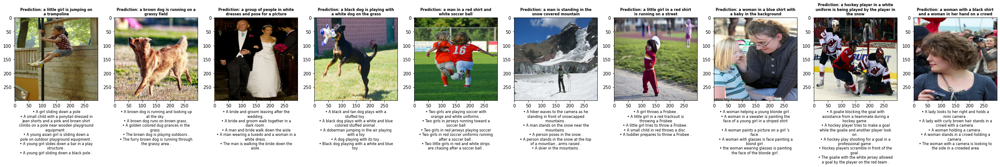

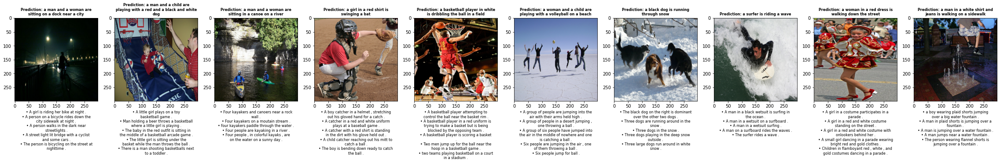

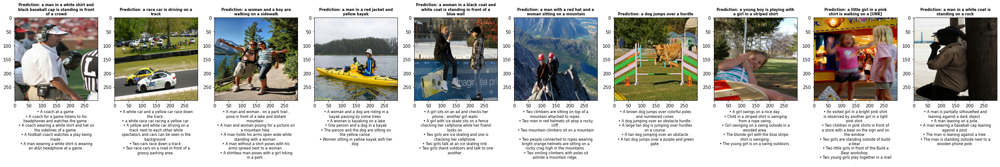

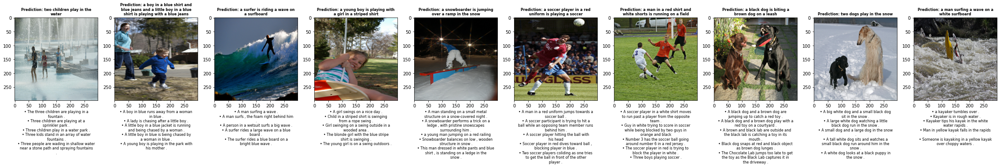

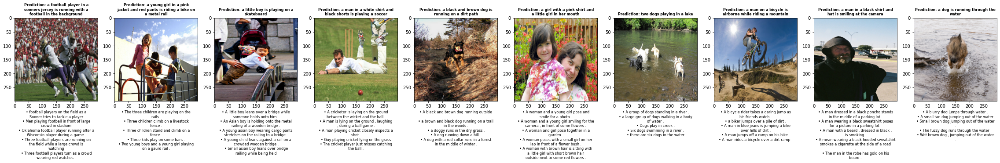

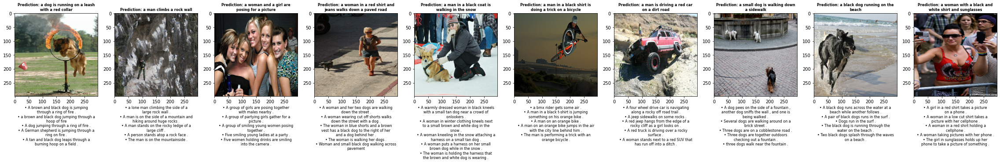

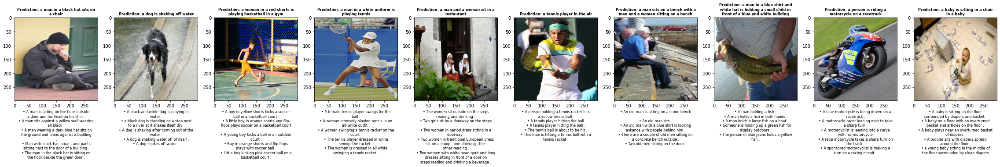

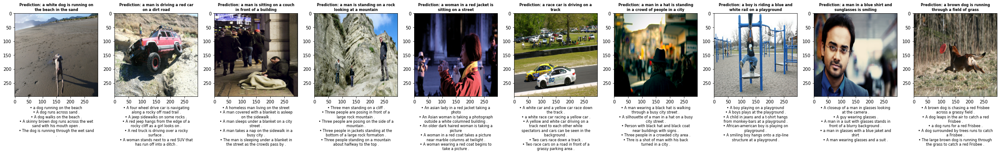

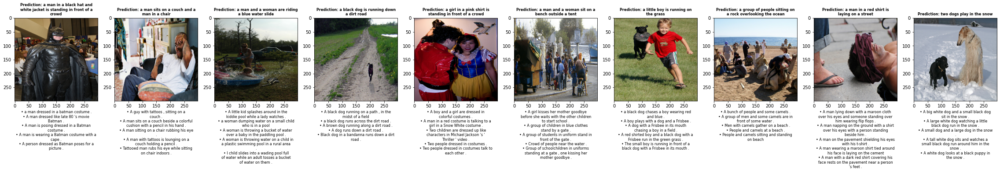

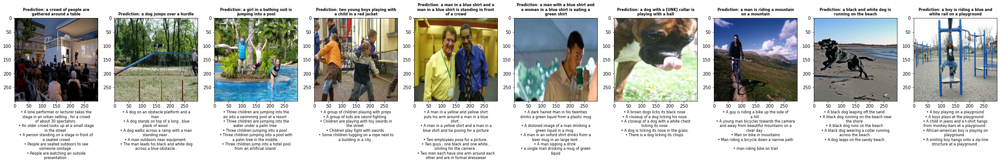

In [48]:
for _ in range(10):
    generate_caption(caption_model, vectorization, valid_data = valid_data,
                     seq_length = SEQ_LENGTH, image_size = IMAGE_SIZE, samples = 10)